In [40]:
def parse_name(name):
    return name.strip('<span title="').split('"')[0]

page = urlopen('http://www.zacks.com/zrank/sector-industry-classification.php')
soup = bs(page.read())
main_body = soup.find('div', {'class': 'main_body'})
script = main_body.find('script')
string = str(script).split('"data"  : ')[-1]
string = string.rstrip('}</script>').strip().rstrip()
string = re.sub('{', '[{', string)
string = re.sub('}', '}]', string)

json_data = json.loads(string)

for group in json_data:
    group_dict = group[0]

    sector_name = parse_name(group_dict['Sector Group'])
    sector_code = group_dict['Sector Code']
    print('sector', sector_code, sector_name)

    industry_name = parse_name(group_dict['Medium(M) Industry Group'])
    industry_code = group_dict['Medium(M) Industry Code']
    print('industry', industry_code, industry_name)

    segment_name = parse_name(group_dict['Expanded(X) Industry Group'])
    segment_code = group_dict['Expanded(X) Industry Code']
    print('segment', segment_code, segment_name)

('sector', u'0', u'Index')
('industry', u'0', u'Indices')
('segment', u'400', u'Indicies')
('sector', u'1', u'Consumer Staples')
('industry', u'3', u'Food')
('segment', u'75', u'Food - Meat Products')
('sector', u'1', u'Consumer Staples')
('industry', u'7', u'Cons Prod-misc Staples')
('segment', u'78', u'Funeral Services')
('sector', u'1', u'Consumer Staples')
('industry', u'3', u'Food')
('segment', u'72', u'Food - Confectionery')
('sector', u'1', u'Consumer Staples')
('industry', u'3', u'Food')
('segment', u'76', u'Food - Miscellaneous')
('sector', u'1', u'Consumer Staples')
('industry', u'5', u'Soaps-cosmetics')
('segment', u'47', u'Cosmetics')
('sector', u'1', u'Consumer Staples')
('industry', u'4', u'Publishing')
('segment', u'148', u'Publishing - Newspapers')
('sector', u'1', u'Consumer Staples')
('industry', u'5', u'Soaps-cosmetics')
('segment', u'174', u'Soap And Cleaning Materials')
('sector', u'1', u'Consumer Staples')
('industry', u'7', u'Cons Prod-misc Staples')
('segment', 

In [73]:
import urllib2
from requests import session
from bs4 import BeautifulSoup
import lxml.html as LH

payload = {
    'action' : 'login',
    'USERNAME': 'tommyhammer',
    'PASSWORD': 'sucregucre'
}

with session() as c:
    c.post('http://whispernumber.com/ValidatePassword.jsp', data=payload)
    response = c.get('http://whispernumber.com/calendar.jsp?day=20170111')


soup = BeautifulSoup(response.text)
    #print soup.prettify()
    #root = LH.fromstring(data)
    #print(''.join(root.xpath(
    #'//td[@id="newNavSub7"]//p[@itemprop="description"]/text()')))
print soup.prettify()
earn = soup.find_all('td',attrs={'class':"newNavSub7"})
print earn
result_list = []
for txt in earn:
    print txt.text
    result_list.append(txt.text)

print result_list

<html>
 <head>
  <script>
   location.replace('signIn.jsp?source=calendar.jsp');
  </script>
 </head>
</html>
[]
[]


In [2]:
from bs4 import BeautifulSoup
import urllib
import pandas as pd
from datetime import timedelta, date

def daterange(start_date, end_date):
    for n in range(int ((end_date - start_date).days)):
        yield start_date + timedelta(n)

dates = []

start_date = date(2012, 1, 3)
end_date = date(2017, 1, 1)
for single_date in daterange(start_date, end_date):
    dates.append(single_date.strftime("%Y-%b-%d"))

#for dt in dates:
cols = ['Comp','Date','FiscQ','EPSest','NumEst','blnk','EPS','Surprise']
masterdf = pd.DataFrame(columns=cols)    

for dt in dates:

    url = 'http://www.nasdaq.com/earnings/earnings-calendar.aspx?date=%s' %dt

    r = urllib.urlopen(url).read()
    soup = BeautifulSoup(r)
    earntbl = soup.find('table', attrs={'class': 'USMN_EarningsCalendar'})
    try:
        earn = earntbl.find_all('td')
        data = []
        for txt in earn:
            data.append(txt.text.strip())
        cos = len(data)/9
        i = 0
        formatted = []
        while i < cos:
            formatted.append([])
            for element in data[(i*9)+1:(i+1)*9]:
                formatted[i].append(element)
            i += 1
        earndf = pd.DataFrame(formatted, columns=cols)
        masterdf = masterdf.append(earndf, ignore_index=True)
    except:
        pass        

print masterdf

                                                    Comp        Date  \
0         Landec Corporation (LNDC) Market Cap: $364.07M  01/03/2012   
1      Progress Software Corporation (PRGS) Market Ca...  01/03/2012   
2                   Team, Inc. (TISI) Market Cap: $1.03B  01/03/2012   
3      Eaton Vance Municipal Bond Fund II (EIV) Marke...  01/04/2012   
4         Mosaic Company (The) (MOS) Market Cap: $11.01B  01/04/2012   
5      National American University Holdings, Inc. (N...  01/04/2012   
6      Resources Connection, Inc. (RECN) Market Cap: ...  01/04/2012   
7                  Sonic Corp. (SONC) Market Cap: $1.19B  01/04/2012   
8           Unifirst Corporation (UNF) Market Cap: $2.7B  01/04/2012   
9          WSI Industries Inc. (WSCI) Market Cap: $8.89M  01/04/2012   
10         A. Schulman, Inc. (SHLM) Market Cap: $958.88M  01/05/2012   
11          Aehr Test Systems (AEHR) Market Cap: $40.24M  01/05/2012   
12       AngioDynamics, Inc. (ANGO) Market Cap: $640.41M  01/05/

In [3]:
masterdf.to_csv('earnings.csv')

In [5]:
mydf = pd.read_csv('earnings.csv')

In [6]:
mydf.head()

,Unnamed: 0,Comp,Date,FiscQ,EPSest,NumEst,blnk,EPS,Surprise
0,0,Landec Corporation (LNDC) Market Cap: $364.07M,01/03/2012,Nov 2011,$0.12,4,n/a,$0.13,8.33
1,1,Progress Software Corporation (PRGS) Market Ca...,01/03/2012,Nov 2011,$0.3,2,n/a,$0.3,Met
2,2,"Team, Inc. (TISI) Market Cap: $1.03B",01/03/2012,Nov 2011,$0.49,5,n/a,$0.53,8.16
3,3,Eaton Vance Municipal Bond Fund II (EIV) Marke...,01/04/2012,Sep 2011,$n/a,0,n/a,$0.21,NaN
4,4,Mosaic Company (The) (MOS) Market Cap: $11.01B,01/04/2012,Nov 2011,$1.3,13,n/a,$1.4,7.69


In [1]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(800, 600))
display.start()

from selenium import webdriver
from selenium.webdriver import ActionChains
from selenium.webdriver.common.by import By
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from selenium.webdriver.common.keys import Keys
import time
from datetime import timedelta, date

def daterange(start_date, end_date):
    for n in range(int ((end_date - start_date).days)):
        yield start_date + timedelta(n)

dates = []

start_date = date(1997, 1, 1)
end_date = date(2017, 1, 1)
for single_date in daterange(start_date, end_date):
    dates.append(single_date.strftime("%m/%d/%Y"))

driver = webdriver.Firefox()
driver.maximize_window()

wait = WebDriverWait(driver, 10)

url = 'https://www.bloomberg.com/markets/earnings-calendar/us'

result = []

driver.get(url)

# pick start date
start_date = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, "input[id=datepicker]")))
start_date.click()

#price = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, ".data-table-body")))
#result.append(price.text)

for dt in dates:    
    dateFld = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, "input[id=datepicker]")))
    #dateFld = driver.find_element_by_id("datepicker")
    dateFld.clear()
    dateFld.send_keys(dt)
    dateFld.send_keys(Keys.RETURN)
    dateFld.send_keys(Keys.RETURN)

    time.sleep(2)

    price = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, ".data-table-body")))
    try:
        result.append(price.text)
    except:
        time.sleep(8)
        price = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, ".data-table-body")))
        result.append(price.text)
driver.close()
print result

[u'', u'2780186Q:US\nElectronic Clearing House Inc\n1/2/1997 Q4/1996 --/-0.124', u'NAUT:US\nNautica Enterprises Inc\n1/3/1997 Q3/1997 0.349/0.370', u'', u'', u'WLTG:US\nWalter Energy Inc\n1/6/1997 Q2/1997 --/0.130', u'', u'HARL:US\nHarleysville Savings Financial Corp\n1/8/1997 Q1/1997 --/0.216', u'MSI:US\nMotorola Solutions Inc\n1/9/1997 Q4/1996 0.985/--', u'DMNM:US\nDominion Minerals Corp\n1/10/1997 Q3/1996 --/-33,599.993\n2639Q:US\nNavient Solutions Inc\n1/10/1997 Y/1996 --/7.420', u'', u'', u'3054Q:US\nAT&T Teleholdings Inc\n1/13/1997 Q4/1996 0.497/0.520\nAVX:US\nAVX Corp\n1/13/1997 Q3/1997 --/0.170\nTXCOQ:US\nReorganized TXCO Inc\n1/13/1997 Q1/1997 --/-0.030', u'APGI:US\nAmerican Power Group Corp\n1/14/1997 Q2/1997 --/-0.800\nBBT:US\nBB&T Corp\n1/14/1997 Q4/1996 0.360/0.325\nMKC:US\nMcCormick & Co Inc/MD\n1/14/1997 Q4/1996 0.296/0.290\nPMLN:US\nPML Inc\n1/14/1997 Q2/1997 --/0.050\nPSFX:US\nPurchaseSoft Inc\n1/14/1997 Q2/1997 --/-2.100\nMTN:US\nVail Resorts Inc\n1/14/1997 Q1/1997 --

In [22]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(800, 600))
display.start()

from selenium import webdriver
from selenium.webdriver import ActionChains
from selenium.webdriver.common.by import By
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from selenium.webdriver.common.keys import Keys
import time
from datetime import timedelta, date

def daterange(start_date, end_date):
    for n in range(int ((end_date - start_date).days)):
        yield start_date + timedelta(n)

dates = []

start_date = date(2016, 1, 1)
end_date = date(2017, 1, 1)
for single_date in daterange(start_date, end_date):
    dates.append(single_date.strftime("%m/%d/%Y"))

driver = webdriver.Firefox()
driver.maximize_window()

wait = WebDriverWait(driver, 10)

url = 'https://www.bloomberg.com/markets/earnings-calendar/us'

result = []

driver.get(url)

# pick start date
start_date = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, "input[id=datepicker]")))
start_date.click()

#price = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, ".data-table-body")))
#result.append(price.text)

for dt in dates:    
    dateFld = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, "input[id=datepicker]")))
    #dateFld = driver.find_element_by_id("datepicker")
    dateFld.clear()
    dateFld.send_keys(dt)
    dateFld.send_keys(Keys.RETURN)
    dateFld.send_keys(Keys.RETURN)

    time.sleep(2)

    price = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, ".data-table-body")))
    try:
        result.append(price.text)
    except:
        time.sleep(8)
        price = wait.until(EC.visibility_of_element_located((By.CSS_SELECTOR, ".data-table-body")))
        result.append(price.text)
driver.close()
print result

['01/01/2016', '01/02/2016', '01/03/2016', '01/04/2016', '01/05/2016', '01/06/2016', '01/07/2016', '01/08/2016', '01/09/2016', '01/10/2016', '01/11/2016', '01/12/2016', '01/13/2016', '01/14/2016', '01/15/2016', '01/16/2016', '01/17/2016', '01/18/2016', '01/19/2016', '01/20/2016', '01/21/2016', '01/22/2016', '01/23/2016', '01/24/2016', '01/25/2016', '01/26/2016', '01/27/2016', '01/28/2016', '01/29/2016', '01/30/2016', '01/31/2016', '02/01/2016', '02/02/2016', '02/03/2016', '02/04/2016', '02/05/2016', '02/06/2016', '02/07/2016', '02/08/2016', '02/09/2016', '02/10/2016', '02/11/2016', '02/12/2016', '02/13/2016', '02/14/2016', '02/15/2016', '02/16/2016', '02/17/2016', '02/18/2016', '02/19/2016', '02/20/2016', '02/21/2016', '02/22/2016', '02/23/2016', '02/24/2016', '02/25/2016', '02/26/2016', '02/27/2016', '02/28/2016', '02/29/2016', '03/01/2016', '03/02/2016', '03/03/2016', '03/04/2016', '03/05/2016', '03/06/2016', '03/07/2016', '03/08/2016', '03/09/2016', '03/10/2016', '03/11/2016', '03/1

In [17]:
for r in result:
    print r.split('\n')

[u'TESTERN3:US', u'*MISTAKE(TEST3-EARNINGS)', u'12/1/2016 Q4/2016 --/--', u'AMBA:US', u'Ambarella Inc', u'12/1/2016 Q3/2017 0.939/1.110', u'AOBC:US', u'American Outdoor Brands Corp', u'12/1/2016 Q2/2017 0.578/0.680', u'AMSWA:US', u'American Software Inc/GA', u'12/1/2016 Q2/2017 0.080/0.030', u'ASNA:US', u'Ascena Retail Group Inc', u'12/1/2016 Q1/2017 0.203/0.180', u'CNO:CN', u'California Nanotechnologies Corp', u'12/1/2016 Q3/2016 --/0.000', u'CNO:CN', u'California Nanotechnologies Corp', u'12/1/2016 Q3/2017 --/--', u'CENT:US', u'Central Garden & Pet Co', u'12/1/2016 Q4/2016 0.053/0.130', u'CBK:US', u'Christopher & Banks Corp', u'12/1/2016 Q3/2017 0.045/0.090', u'CFI:US', u'Culp Inc', u'12/1/2016 Q2/2017 0.455/0.470', u'DG:US', u'Dollar General Corp', u'12/1/2016 Q3/2017 0.928/0.890', u'DCI:US', u'Donaldson Co Inc', u'12/1/2016 Q1/2017 0.350/0.380', u'EXPR:US', u'Express Inc', u'12/1/2016 Q3/2017 0.129/0.148', u'FIVE:US', u'Five Below Inc', u'12/1/2016 Q3/2017 0.094/0.100', u'GIII:US',

In [1]:
import pickle

with open('outfile', 'wb') as fp:
    pickle.dump(result, fp)

NameError: name 'result' is not defined

In [1]:
import pickle
with open ('outfile', 'rb') as fp:
    itemlist = pickle.load(fp)

EOFError: 

In [17]:
newlist = []
for r in itemlist:
    if len(r) == 0:
        pass
    else:
        newlist.append(r.split('\n'))

newlist[:50]

finallist = []
for ele in newlist:
    lng = len(ele)/3
    for i in range(lng):
        start = i*3
        end = (i+1)*3
        finallist.append(ele[start:end])

In [18]:
import pandas as pd

df = pd.DataFrame(finallist,columns=['Ticker','Name','Data'])

#df.head(100)

In [9]:
import pandas as pd
from StringIO import StringIO
from zipfile import ZipFile
from urllib import urlopen
cols=['Date','Time','Open','High','Low','Close','Volume']
url = urlopen("http://quantquote.com/files/quantquote_daily_sp500_83986.zip")
zipfile = ZipFile(StringIO(url.read()))
masterdf = pd.DataFrame()
for name in zipfile.namelist()[2:]:
    qt = name.split('_')[-1].split('.')[0]
    qtfile = zipfile.open(name)
    qtdf = pd.read_csv(qtfile,header=None,names=cols)
    qtdf['Ticker'] = qt
    masterdf = masterdf.append(qtdf,ignore_index=True)

masterdf

,Date,Time,Open,High,Low,Close,Volume,Ticker
0,19991118,0,42.2076,46.3820,37.4581,39.1928,4.398181e+07,a
1,19991119,0,39.8329,39.8885,36.9293,37.6251,1.139020e+07,a
2,19991122,0,38.3208,40.0091,37.1613,39.9442,4.654716e+06,a
3,19991123,0,39.4247,40.4729,37.3375,37.5138,4.268903e+06,a
4,19991124,0,37.2262,38.9052,37.1056,38.0889,3.602367e+06,a
5,19991126,0,37.9219,38.4971,37.8013,38.2095,1.332198e+06,a
6,19991129,0,38.0332,39.3690,37.6251,38.9052,3.038788e+06,a
7,19991130,0,38.9609,39.8329,37.9776,39.1371,2.968070e+06,a
8,19991201,0,39.1371,40.2967,38.8496,40.1204,2.198051e+06,a
9,19991202,0,40.5842,41.7438,40.0648,41.5119,2.308009e+06,a


In [10]:
masterdf.to_csv('returns.csv')

In [19]:
import pandas as pd
stocks = pd.read_csv('returns.csv')

In [ ]:
#clean data
df['Tick'] = df['Ticker'].str.split(':').str[0]
df['Date'] = df['Data'].str.split().str[0]
df['Quarter'] = df['Data'].str.split().str[1]
df['Estimate'] = df['Data'].str.split().str[2].str.split('/').str[0]
df['Actual'] = df['Data'].str.split().str[2].str.split('/').str[1]
df['Date'] = pd.to_datetime(df['Date'], format='%m/%d/%Y')

In [7]:
stocks['Date'] = pd.to_datetime(stocks['Date'], format='%Y%m%d')
stocks['Tick'] = stocks['Ticker'].str.upper()

In [23]:
#interim save
df.to_csv('cleanearn.csv')
stocks.to_csv('cleanstocks.csv')

In [2]:
import pandas as pd
stock = pd.read_csv('cleanstocks.csv')
earn = pd.read_csv('cleanearn.csv')

In [3]:
earn['Date'] = pd.to_datetime(earn['Date'], format='%Y-%m-%d')
stock['Date'] = pd.to_datetime(stock['Date'], format='%Y-%m-%d')

In [4]:
earn.Estimate = pd.to_numeric(earn.Estimate, errors='coerce')
earn.Actual = pd.to_numeric(earn.Actual, errors='coerce')

In [6]:
earn = earn[earn['Quarter'].str.contains(r'^Q.*')]

In [7]:
earn = earn.drop_duplicates(subset=['Ticker','Date'])

In [8]:
comb = stock.merge(earn,on=['Date','Tick'])

In [9]:
comb['Intraday'] = (comb['Close']-comb['Open'])/comb['Open']
comb['Surprise'] = (comb['Actual']-comb['Estimate'])/comb['Estimate']

In [10]:
comb['SurpriseVal'] = comb['Actual']-comb['Estimate']

In [11]:
comb = comb.drop(['Unnamed: 0_x', 'Unnamed: 0.1','Time','Ticker_x','Unnamed: 0_y','Ticker_y','Data'], axis=1)

In [24]:
clean = comb.dropna(subset=['Surprise'])

In [25]:
comb[comb['Surprise'].isnull()]

,Date,Open,High,Low,Close,Volume,Tick,Name,Quarter,Estimate,Actual,Intraday,Surprise
0,1999-12-16,38.96090,42.26330,38.96090,42.09630,1.962184e+06,A,Agilent Technologies Inc,Q4/1999,NaN,0.320,0.080476,NaN
1,2000-02-17,75.13880,77.45790,72.01270,76.53030,7.053381e+05,A,Agilent Technologies Inc,Q1/2000,NaN,0.190,0.018519,NaN
2,2000-05-16,83.60820,89.92540,83.48760,88.76590,4.324956e+06,A,Agilent Technologies Inc,Q2/2000,NaN,0.270,0.061689,NaN
3,2000-08-17,40.00910,43.83100,40.00910,43.25580,7.164419e+06,A,Agilent Technologies Inc,Q3/2000,NaN,0.330,0.081149,NaN
4,2000-11-20,43.48780,43.54340,40.63990,41.40060,3.066170e+06,A,Agilent Technologies Inc,Q4/2000,NaN,0.520,-0.047995,NaN
5,2001-02-20,45.63990,45.87180,39.88850,41.04810,4.627012e+06,A,Agilent Technologies Inc,Q1/2001,NaN,0.500,-0.100609,NaN
6,2001-05-17,35.25030,36.64180,34.80500,35.89970,2.121082e+06,A,Agilent Technologies Inc,Q2/2001,NaN,0.040,0.018423,NaN
7,2001-08-20,24.21140,24.45260,23.46000,24.26710,1.616683e+06,A,Agilent Technologies Inc,Q3/2001,NaN,-0.250,0.002301,NaN
8,2001-11-15,23.19100,23.55280,22.45820,23.20030,1.868613e+06,A,Agilent Technologies Inc,Q4/2001,NaN,-0.600,0.000401,NaN
9,2002-02-19,24.86070,24.93500,24.11860,24.22070,1.736989e+06,A,Agilent Technologies Inc,Q1/2002,NaN,-0.290,-0.025743,NaN


In [14]:
len(clean)

18255

(-1, 1)

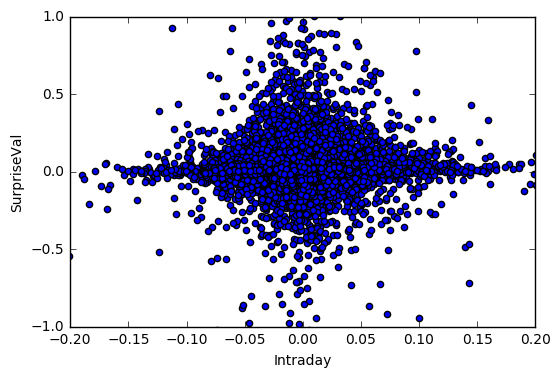

In [39]:
%matplotlib inline
import matplotlib.pyplot as plt

fig = plt.figure()
ax = plt.subplot(111)
clean.plot(x='Intraday',y='SurpriseVal',ax=ax, kind='scatter')
ax.set_xlim(-.2,.2)
ax.set_ylim(-1,1)



In [29]:
from sklearn import datasets, linear_model

x = clean.Intraday.values
y = clean.SurpriseVal.values

x = x.reshape(len(clean),1)
y = y.reshape(len(clean),1)

In [30]:
regr = linear_model.LinearRegression()
regr.fit(x, y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [32]:
regr.score(x,y)

0.00086648504754971434

In [35]:
regr.coef_

array([[ 1.91621794]])

In [25]:
from datetime import timedelta, date
clean['Day_Before'] = clean['Date'] - timedelta(days=1)

/opt/conda/lib/python2.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [26]:
clean['Week_Before'] = clean['Date'] - timedelta(days=7)

/opt/conda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [30]:
stock2 = stock[['Date','Tick','Open','Close']]

In [31]:
clean2 = clean.merge(stock2, how='left', left_on=['Day_Before','Tick'],right_on=['Date','Tick'], suffixes=("_D","DB"),copy=False)

In [34]:
clean3 = clean2.dropna(subset=['OpenDB'])

In [38]:
#clean3.head()
clean3['Overnight'] = (clean3['Open_D']-clean3['CloseDB'])/clean3['CloseDB']

/opt/conda/lib/python2.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [39]:
clean3.head()

,Date_D,Open_D,High,Low,Close_D,Volume,Tick,Name,Quarter,Estimate,Actual,Intraday,Surprise,SurpriseVal,Day_Before,Week_Before,DateDB,OpenDB,CloseDB,Overnight
4,2007-11-15,33.1884,34.4092,33.0407,33.1982,2.338080e+06,A,Agilent Technologies Inc,Q4/2007,0.516,0.47,0.000295,-0.089147,-0.046,2007-11-14,2007-11-08,2007-11-14,33.5231,33.6216,-0.012885
5,2008-02-13,31.5541,32.6469,31.4261,32.2137,5.923034e+06,A,Agilent Technologies Inc,Q1/2008,0.393,0.34,0.020904,-0.134860,-0.053,2008-02-12,2008-02-06,2008-02-12,31.5049,31.3375,0.006912
6,2008-05-14,31.9479,32.7355,31.8593,31.9774,2.666042e+06,A,Agilent Technologies Inc,Q2/2008,0.459,0.46,0.000923,0.002179,0.001,2008-05-13,2008-05-07,2008-05-13,31.8888,31.7707,0.005577
7,2009-05-14,17.7510,18.1842,17.0717,18.0562,3.129747e+06,A,Agilent Technologies Inc,Q2/2009,0.127,0.12,0.017193,-0.055118,-0.007,2009-05-13,2009-05-07,2009-05-13,18.3811,17.8101,-0.003318
9,2010-02-12,30.1757,30.2644,29.1125,29.5161,7.435938e+06,A,Agilent Technologies Inc,Q1/2010,0.321,0.38,-0.021859,0.183801,0.059,2010-02-11,2010-02-05,2010-02-11,28.7974,28.9254,0.043225


In [41]:
from sklearn import datasets, linear_model

x = clean3.Overnight.values
y = clean3.SurpriseVal.values

x = x.reshape(len(clean3),1)
y = y.reshape(len(clean3),1)

regr = linear_model.LinearRegression()
regr.fit(x, y)

regr.score(x,y)

0.0011688934273434981

In [42]:
regr.coef_

array([[ 0.91794064]])

(-1, 1)

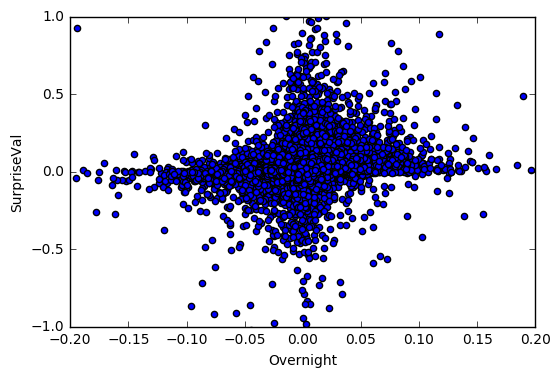

In [51]:
%matplotlib inline
import matplotlib.pyplot as plt

fig = plt.figure()
ax = plt.subplot(111)
clean3.plot(x='Overnight',y='SurpriseVal',ax=ax, kind='scatter')
ax.set_xlim(-.2,.2)
ax.set_ylim(-1,1)

In [45]:
clean4 = clean3.merge(stock2, how='left', left_on=['Week_Before','Tick'],right_on=['Date','Tick'], suffixes=("_D","WB"),copy=False)

In [48]:
clean4.head()
clean5 = clean4.dropna(subset=['Open'])

In [49]:
clean5['WeekBClose'] = (clean5['Close_D']-clean5['Close'])/clean5['Close']

x = clean5.Overnight.values
y = clean5.SurpriseVal.values

x = x.reshape(len(clean5),1)
y = y.reshape(len(clean5),1)

regr = linear_model.LinearRegression()
regr.fit(x, y)

regr.score(x,y)

/opt/conda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


0.0010960061301269475

(-1, 1)

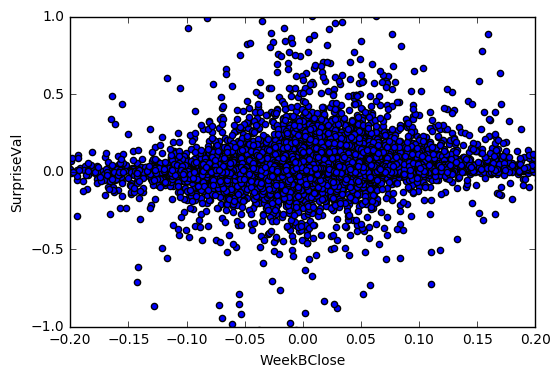

In [50]:
fig = plt.figure()
ax = plt.subplot(111)
clean5.plot(x='WeekBClose',y='SurpriseVal',ax=ax, kind='scatter')
ax.set_xlim(-.2,.2)
ax.set_ylim(-1,1)